#EE610 Assignment 2
##Author: ```Harsh Pal```
##Roll No. : ```18D070012```


#Setting up project directory

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
%cd /content/gdrive/MyDrive/EE610-Assignment-2

/content/gdrive/MyDrive/EE610-Assignment-2


#Importing libraries

In [9]:
# python utilities 
import cv2
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import image
import math
import zipfile
import tensorflow as tf
import random
from tqdm import tqdm
from glob import glob
from PIL import Image, ImageOps

# ml utilities
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

from keras import backend as K
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Dropout, BatchNormalization, Input
from tensorflow.keras.callbacks import EarlyStopping

%matplotlib inline

# Dataset preparation

In [4]:
# following types of noises are used for image degradation
noise_types = ['gaussian','poisson','s&p']

# following kernel sizes are used for gaussian blurring
# kernel sizes bigger than this severly degrade the image and whose
# reconstruction is nearly inpossible due to information loss
filter_sizes = [3,5,7]


# for each image, the noise type and filter size is selected randomly
# random noise functon
def random_noised(image, noise):
    if noise == "gaussian":
        row,col,ch= image.shape
        mean = 0
        #var = 0.1
        gauss = np.random.normal(mean,0.1,(row,col,ch))
        gauss = gauss.reshape(row,col,ch)
        noisy = image + gauss
        return noisy
        
    elif noise == "s&p":
        row,col,ch = image.shape
        s_vs_p = 0.5
        amount = 0.04
        out = image
        # salt mode
        num_salt = np.ceil(amount * image.size * s_vs_p)
        coords = [np.random.randint(0, i - 1, int(num_salt))
                  for i in image.shape]
        out[coords] = 1

        # pepper mode
        num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
        coords = [np.random.randint(0, i - 1, int(num_pepper))
                  for i in image.shape]
        out[coords] = 0
        return out
    
    elif noise == "poisson":
        vals = len(np.unique(image))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(image * vals) / float(vals)
        return noisy
        

# image prepare function
def process_image1(path):
    rand_noise = random.choice(noise_types)
    rand_size = random.choice(filter_sizes)
    
    img = cv2.imread(path, 1)
    img = cv2.resize(img, (200, 200))
    img = img/255.0
    
    blur_img = cv2.GaussianBlur(img, (rand_size, rand_size), 0)
    noisy_blur_img = random_noised(blur_img, rand_noise)
    
    return noisy_blur_img

###BSDS300 Dataset

In [ ]:
# preparing train_noised from train
# preparing test_noised from test
dir_list = os.listdir('/content/gdrive/MyDrive/EE610-Assignment-2/BSDS300/images/train')
for f in tqdm(dir_list):
    path = '/content/gdrive/MyDrive/EE610-Assignment-2/BSDS300/images/train/' + f
    img = process_image1(path)*255.0
    store_path = '/content/gdrive/MyDrive/EE610-Assignment-2/BSDS300/images/train_noised/' + f
    cv2.imwrite(store_path, img)

# Dataloading
**Note:** Not using dataloader like ``` tf.keras.datasets``` because it is observed that model take more time while training when pre-configured dataloader is used

### Note on Data preprocessing:
- The dataset given, BSDS300, was of size 481*321.
- It was essential to resize for fast training, however it will decrease the sharpness of the images which will affect the model performance.
- Hence images are resized to size (200, 200, 3) after multiple run in sanity checking and analysing the above trade-off

In [4]:
# prepare function
def process_image(path):
    img = cv2.imread(path)
    img = cv2.resize(img, (200, 200), interpolation = cv2.INTER_CUBIC)
    img = img/255.0
    return img

In [5]:
# preprocess images
train = []
train_noised = []
test = []
path = '/content/gdrive/MyDrive/EE610-Assignment-2/BSDS300/images/'

for f in sorted(os.listdir(path + 'train/')):
    train.append(process_image(path + 'train/' + f))

for f in sorted(os.listdir(path + 'train_noised/')):
    train_noised.append(process_image(path + 'train_noised/' + f))
   
for f in sorted(os.listdir(path + 'test_noised/')):
    test.append(process_image(path + 'test_noised/' + f))

In [ ]:
# store image names in list for later use
train_img = sorted(os.listdir(path + '/train'))
train_noised_img = sorted(os.listdir(path + '/train_noised'))
test_img = sorted(os.listdir(path + '/test_noised'))

In [ ]:
# convert list to numpy array
X_train = np.asarray(train_noised)
Y_train = np.asarray(train)
X_test = np.asarray(test)

X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.15, random_state=42)

In [ ]:
Y_pred = model
psnr1 = tf.image.psnr(X_train[1], Y_train[1], max_val=1)
psnr1.numpy()

24.078321

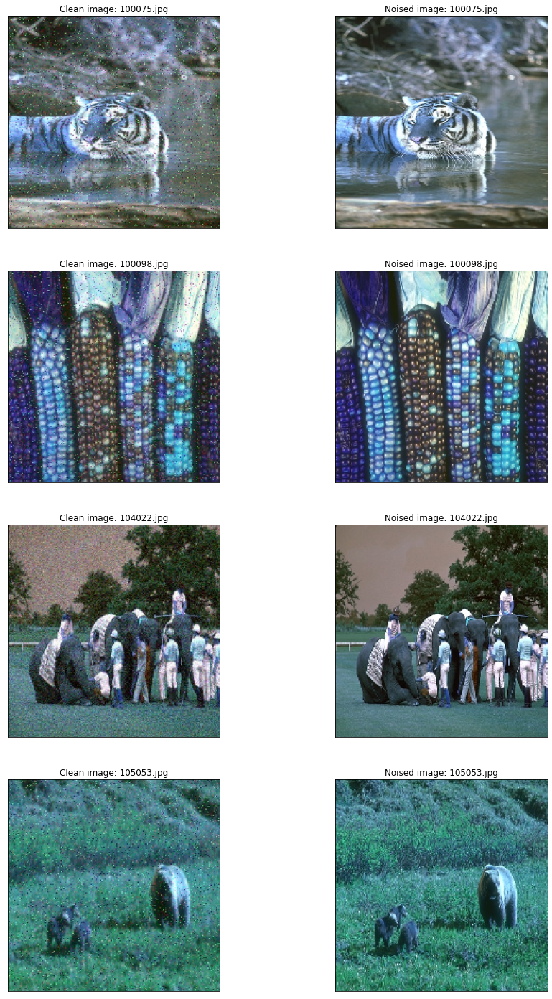

In [ ]:
#Visualizing sample dataset
plt.figure(figsize=(15,25))
for i in range(0,8,2):
    plt.subplot(4,2,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(X_train[i])
    plt.title('Clean image: {}'.format(train_img[i]))
    
    plt.subplot(4,2,i+2)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(Y_train[i])
    plt.title('Noised image: {}'.format(train_img[i]))

plt.show()

In [ ]:
Y_train[0].shape

(150, 150, 3)

In [8]:
def model():
    input_layer = Input(shape=(200, 200, 3))

    # encoding
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (5, 5), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Dropout(0.4)(x)

    # decoding
    x = Conv2D(128, (5, 5), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)

    output_layer = layers.Conv2D(3, (3, 3), activation="sigmoid", padding="same")(x)
    
    model = Model(inputs=[input_layer], outputs=[output_layer])
    optimizer = keras.optimizers.Adam(learning_rate=0.001)
    model.compile(optimizer=optimizer , loss='mean_squared_error', metrics=['mse'])

    return model


model = model()
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 200, 200, 3)]     0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 200, 200, 64)      1792      
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 200, 200, 64)      36928     
_________________________________________________________________
batch_normalization_2 (Batch (None, 200, 200, 64)      256       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 200, 200, 128)     204928    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 100, 100, 128)     0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 100, 100, 128)     0   

## Sanity checking
- **Overfitting** a CNN model on a **single image** and observe the variation of train and validation error with total epochs to get the idea of expecting loss and epochs required while main training
-Adopting **Data centric** approach for model training. So focusing on data by multiple experimentation on single model. Although hyperparameter was tweaked according to the dataset(*Encoder-Decoder* in our case)

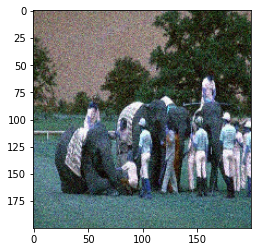

In [ ]:
# sample image
plt.imshow(X_train[4])

In [ ]:
X_samp = X_train[4]
Y_samp = Y_train[4]

X_samp = np.expand_dims(X_samp, axis=1)
Y_samp = np.expand_dims(Y_samp, axis=1)

In [ ]:
def scheduler(epoch, lr):
  if epoch < 200:
    return lr
  else:
    return lr * tf.math.exp(-0.1)

#callback1 = EarlyStopping(monitor='loss', patience=10)
#callback2 = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)
callback3 = keras.callbacks.LearningRateScheduler(scheduler)

# training on single image: X_samp
history = model.fit(X_samp, Y_samp, validation_data = (X_samp, Y_samp), epochs=1500, batch_size=1, verbose=1, callbacks=[callback3])

Epoch 1/1500
1/1 [==============================] - 1s 1s/step - loss: 0.1083 - mse: 0.1083 - val_loss: 0.0672 - val_mse: 0.0672
Epoch 2/1500
1/1 [==============================] - 0s 203ms/step - loss: 0.0497 - mse: 0.0497 - val_loss: 0.0657 - val_mse: 0.0657
Epoch 3/1500
1/1 [==============================] - 0s 187ms/step - loss: 0.0225 - mse: 0.0225 - val_loss: 0.0607 - val_mse: 0.0607
Epoch 4/1500
1/1 [==============================] - 0s 177ms/step - loss: 0.0330 - mse: 0.0330 - val_loss: 0.0725 - val_mse: 0.0725
Epoch 5/1500
1/1 [==============================] - 0s 165ms/step - loss: 0.0194 - mse: 0.0194 - val_loss: 0.0880 - val_mse: 0.0880
Epoch 6/1500
1/1 [==============================] - 0s 161ms/step - loss: 0.0211 - mse: 0.0211 - val_loss: 0.0927 - val_mse: 0.0927
Epoch 7/1500
1/1 [==============================] - 0s 164ms/step - loss: 0.0195 - mse: 0.0195 - val_loss: 0.0893 - val_mse: 0.0893
Epoch 8/1500
1/1 [==============================] - 0s 159ms/step - loss: 0.017

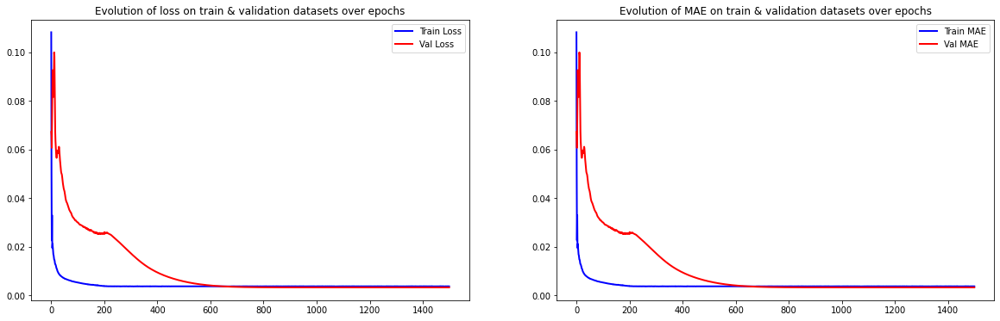

In [ ]:
# Check how loss & mae went down
epoch_loss = history.history['loss']
epoch_val_loss = history.history['val_loss']
epoch_mae = history.history['mse']
epoch_val_mae = history.history['val_mse']

plt.figure(figsize=(20,6))
plt.subplot(1,2,1)
plt.plot(range(0,len(epoch_loss)), epoch_loss, 'b-', linewidth=2, label='Train Loss')
plt.plot(range(0,len(epoch_val_loss)), epoch_val_loss, 'r-', linewidth=2, label='Val Loss')
plt.title('Evolution of loss on train & validation datasets over epochs')
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(range(0,len(epoch_mae)), epoch_mae, 'b-', linewidth=2, label='Train MAE')
plt.plot(range(0,len(epoch_val_mae)), epoch_val_mae, 'r-', linewidth=2,label='Val MAE')
plt.title('Evolution of MAE on train & validation datasets over epochs')
plt.legend(loc='best')

plt.show()

## Sanity Testing

In [ ]:
# predict/clean test images
Y_test_samp = model.predict(X_samp)
Y_test_samp = np.reshape(Y_test_samp, (200, 200, 3))

In [ ]:
X_samp = np.reshape(X_samp, (200, 200, 3))
Y_samp = np.reshape(Y_samp, (200, 200, 3))

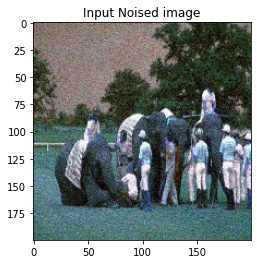

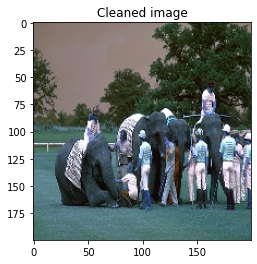

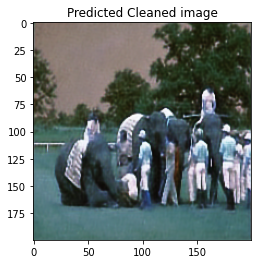

In [ ]:
plt.imshow(X_samp)
plt.title('Input Noised image')
plt.show()
plt.imshow(Y_samp)
plt.title('Cleaned image')
plt.show()
plt.imshow(Y_test_samp)
plt.title('Predicted Cleaned image')
plt.show()

###Comments:
- Expected number of required epochs is around 1000-1500
- A reasonable model can have losses(**MSE**) near to 0.003 

#Modeling
- I am using **encoder-decoder** deep CNN model and training it **end to end**. The trained model obtained will be *image to image* mapping.
- **Encoder** has three convolutional blocks for extracting the features from an input image followed by batchnormalization, maxpooli and dropout. It maps the input into a *latent space* which is basically extraction of image features.
- **Decoder** has complementary function as well as architechture to the encoder. It regenerates the image from the *latent space*

#Windowing
- I am **Not** using the windowing method. I am training end to end model. Which is basically training with whole input image without patching

#Hyperparameter Tuning
- I chose model to be low weighted or with less parameters because during sanity checking I find that for significant results I need to train my model for epoch size 1500-2000 and with heavy model, training will take significant amount of time
- There is a trade-off between choosing a big model and training time. Since my approach is *Data centric* so I will require to train my model for multiple times and analysing the performance with metrics
- **LR scheduling** is used for learning rate decay for better convergence at the end epochs. ```Time-based scheduling``` came out to be the best among other(can be seen in the comments)
- ```Total epochs``` was chosen after training a model for large no. of epoch and then selecting the epochs from where the overfitting starts. In this case it was 1000.
* The corresponding loss plot(```sweet_spot.jpg```) can be found in the assignment directory

## Final Model training

In [10]:
def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return 10.0 * (1.0 / math.log(10)) * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - 
y_true))))
    

def model():
    input_layer = Input(shape=(200, 200, 3))

    # encoding
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_layer)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (5, 5), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Dropout(0.4)(x)

    # decoding
    x = Conv2D(128, (5, 5), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)

    output_layer = layers.Conv2D(3, (3, 3), activation="sigmoid", padding="same")(x)
    
    model = Model(inputs=[input_layer], outputs=[output_layer])
    optimizer = keras.optimizers.Adam(learning_rate=0.001)
    model.compile(optimizer=optimizer , loss='mean_squared_error', metrics=[PSNR])

    return model


model = model()
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 200, 200, 3)]     0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 200, 200, 64)      1792      
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 200, 200, 64)      36928     
_________________________________________________________________
batch_normalization_4 (Batch (None, 200, 200, 64)      256       
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 200, 200, 128)     204928    
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 100, 100, 128)     0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 100, 100, 128)     0   

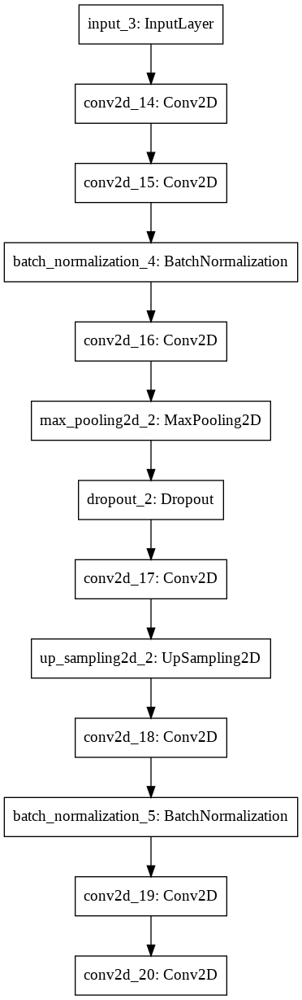

In [11]:
tf.keras.utils.plot_model(model)

In [ ]:
# used for adaptive variation of learning rate
# # https://towardsdatascience.com/learning-rate-schedule-in-practice-an-example-with-keras-and-tensorflow-2-0-2f48b2888a0c#:~:text=The%20constant%20learning%20rate%20is%20the%20default%20schedule,And%20to%20fit%20the%20model%20to%20training%20data%3A
def scheduler(epoch, lr):
  # # exponential decay
  # if epoch < 20:
  #   return lr
  # else:
  #   # return lr * tf.math.exp(-0.1)

  # # step decay
  # drop_rate = 0.5
  # epoch_drop = 10
  # return lr * pow(drop_rate, tf.math.floor(epoch/epoch_drop))

  # time-based decay
  decay = 0.001/500  # chosen by experimentation
  return lr * 1/(1 + decay*epoch)

# callbacks for regularization and optimal stopping point
#callback1 = EarlyStopping(monitor='loss', patience=10)
#callback2 = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

callback3 = keras.callbacks.LearningRateScheduler(scheduler, 1)

history = model.fit(X_train, Y_train, validation_data = (X_val, Y_val), epochs=1000, batch_size=8, verbose=1, callbacks=[callback3])

Epoch 1/1000

Epoch 00001: LearningRateScheduler setting learning rate to 0.0010000000474974513.
22/22 [==============================] - 52s 749ms/step - loss: 0.0238 - PSNR: 16.9975 - val_loss: 0.0683 - val_PSNR: 11.6654
Epoch 2/1000

Epoch 00002: LearningRateScheduler setting learning rate to 0.0009999980475013564.
22/22 [==============================] - 11s 479ms/step - loss: 0.0135 - PSNR: 18.8646 - val_loss: 0.0421 - val_PSNR: 13.7750
Epoch 3/1000

Epoch 00003: LearningRateScheduler setting learning rate to 0.0009999940684607064.
22/22 [==============================] - 11s 480ms/step - loss: 0.0112 - PSNR: 19.5163 - val_loss: 0.0455 - val_PSNR: 13.4236
Epoch 4/1000

Epoch 00004: LearningRateScheduler setting learning rate to 0.000999988110387376.
22/22 [==============================] - 11s 480ms/step - loss: 0.0124 - PSNR: 19.0457 - val_loss: 0.0443 - val_PSNR: 13.5555
Epoch 5/1000

Epoch 00005: LearningRateScheduler setting learning rate to 0.0009999800568788481.
22/22 [=====

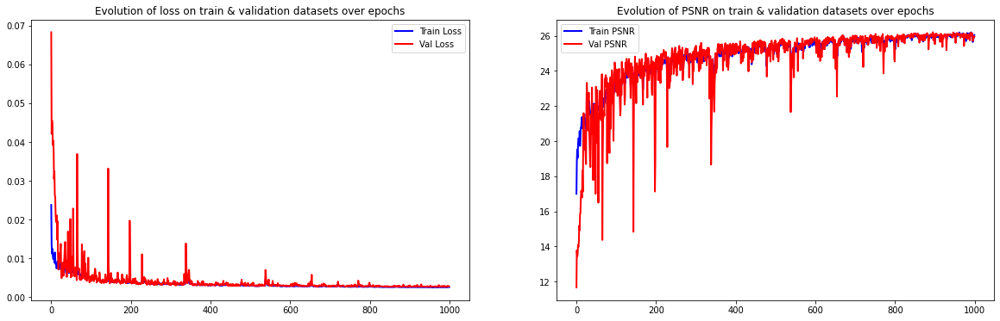

In [ ]:
# Check how loss & mae went down
epoch_loss = history.history['loss']
epoch_val_loss = history.history['val_loss']
epoch_psnr = history.history['PSNR']
epoch_val_psnr = history.history['val_PSNR']

plt.figure(figsize=(20,6))
plt.subplot(1,2,1)
plt.plot(range(0,len(epoch_loss)), epoch_loss, 'b-', linewidth=2, label='Train Loss')
plt.plot(range(0,len(epoch_val_loss)), epoch_val_loss, 'r-', linewidth=2, label='Val Loss')
plt.title('Evolution of loss on train & validation datasets over epochs')
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(range(0,len(epoch_psnr)), epoch_psnr, 'b-', linewidth=2, label='Train PSNR')
plt.plot(range(0,len(epoch_val_psnr)), epoch_val_psnr, 'r-', linewidth=2, label='Val PSNR')
plt.title('Evolution of PSNR on train & validation datasets over epochs')
plt.legend(loc='best')

plt.show()


In [ ]:
# saving model
model.save('model_3')

INFO:tensorflow:Assets written to: model_3/assets


### Inferences from loss plots and training
- The model achieves very good ```mse = 0.0026``` at the end of training and ```PSNR ~ 26```
- Initially there was an **overfitting** observed aroung epoch 1100, so I fixed total epochs 1000.


#Testing

In [ ]:
from keras.models import load_model
model = load_model('/content/gdrive/MyDrive/EE610-Assignment-2/model_3')

### For better color visualization, plotting with ```cv2_imshow```

Image no. : 101085.jpg
Noised Image


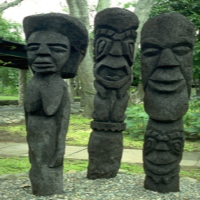

Cleaned Image


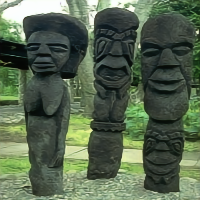

 
 

Image no. : 101087.jpg
Noised Image


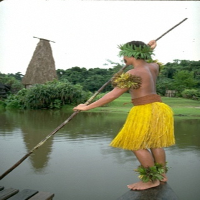

Cleaned Image


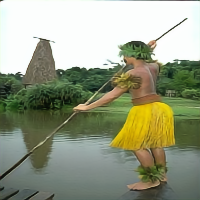

 
 

Image no. : 102061.jpg
Noised Image


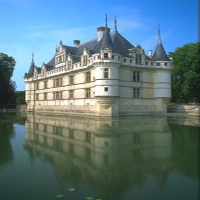

Cleaned Image


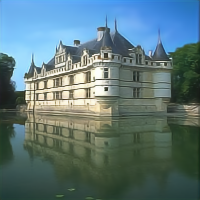

 
 

Image no. : 103070.jpg
Noised Image


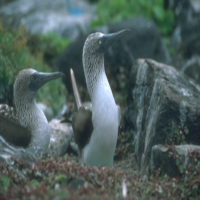

Cleaned Image


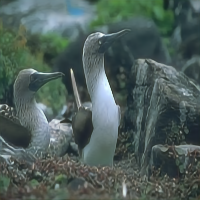

 
 

Image no. : 105025.jpg
Noised Image


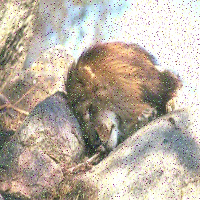

Cleaned Image


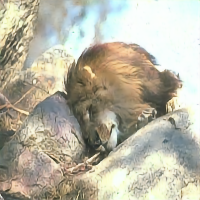

 
 

Image no. : 106024.jpg
Noised Image


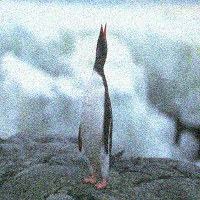

Cleaned Image


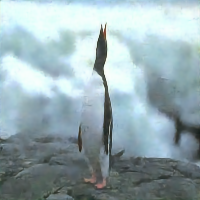

 
 

Image no. : 108005.jpg
Noised Image


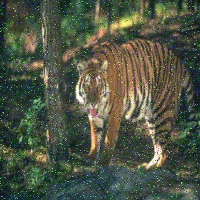

Cleaned Image


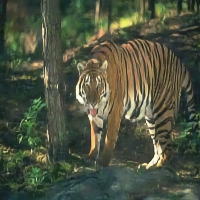

 
 

Image no. : 108070.jpg
Noised Image


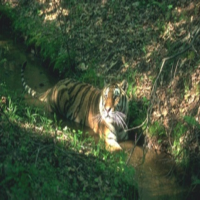

Cleaned Image


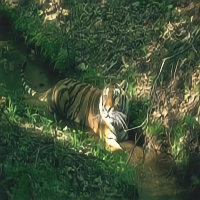

 
 

Image no. : 108082.jpg
Noised Image


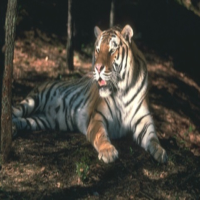

Cleaned Image


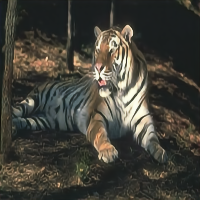

 
 

Image no. : 109053.jpg
Noised Image


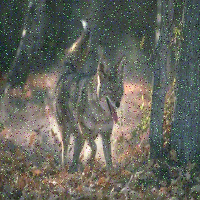

Cleaned Image


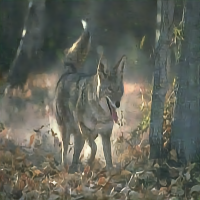

 
 

Image no. : 119082.jpg
Noised Image


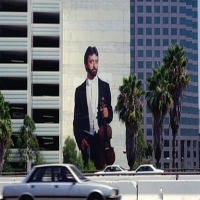

Cleaned Image


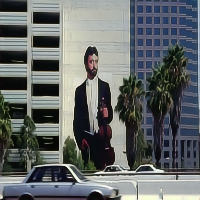

 
 

Image no. : 12084.jpg
Noised Image


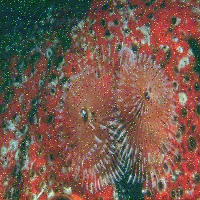

Cleaned Image


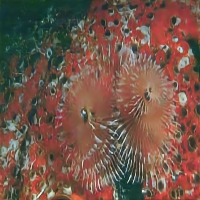

 
 

Image no. : 123074.jpg
Noised Image


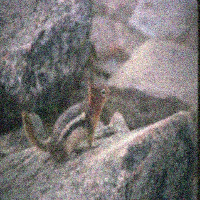

Cleaned Image


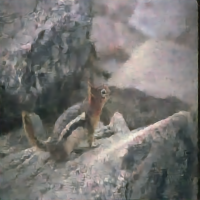

 
 

Image no. : 126007.jpg
Noised Image


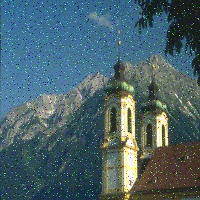

Cleaned Image


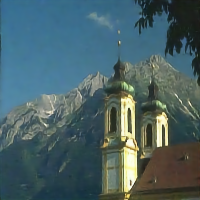

 
 

Image no. : 130026.jpg
Noised Image


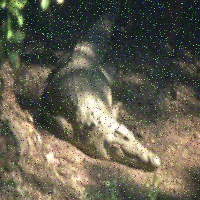

Cleaned Image


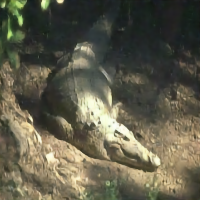

 
 

Image no. : 134035.jpg
Noised Image


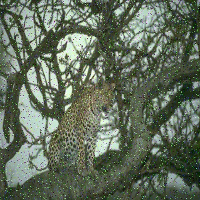

Cleaned Image


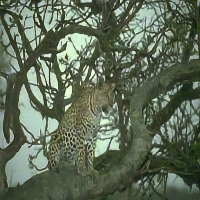

 
 

Image no. : 14037.jpg
Noised Image


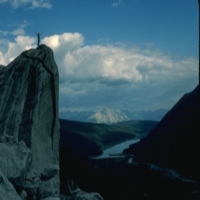

Cleaned Image


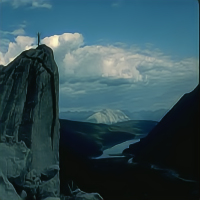

 
 

Image no. : 143090.jpg
Noised Image


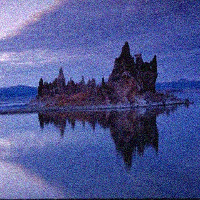

Cleaned Image


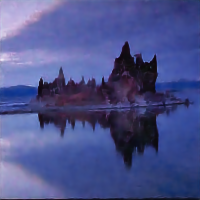

 
 

Image no. : 145086.jpg
Noised Image


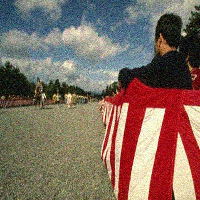

Cleaned Image


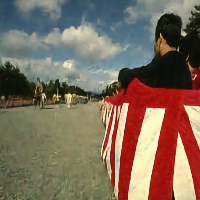

 
 

Image no. : 147091.jpg
Noised Image


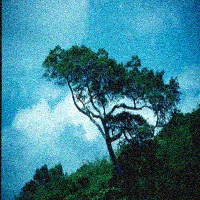

Cleaned Image


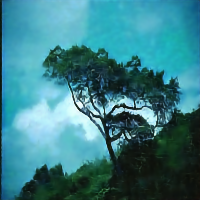

 
 

Image no. : 148026.jpg
Noised Image


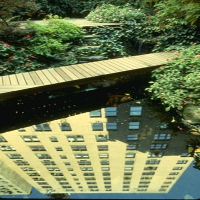

Cleaned Image


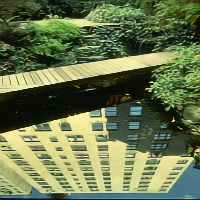

 
 

Image no. : 148089.jpg
Noised Image


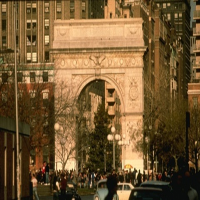

Cleaned Image


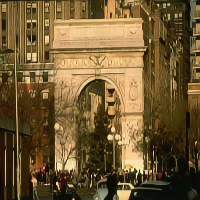

 
 

Image no. : 156065.jpg
Noised Image


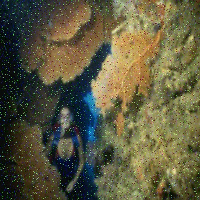

Cleaned Image


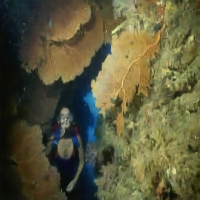

 
 

Image no. : 157055.jpg
Noised Image


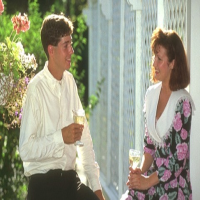

Cleaned Image


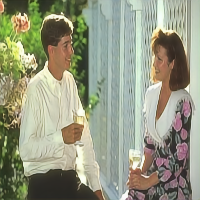

 
 

Image no. : 159008.jpg
Noised Image


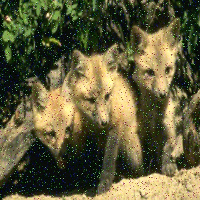

Cleaned Image


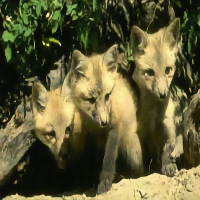

 
 

Image no. : 160068.jpg
Noised Image


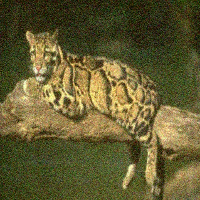

Cleaned Image


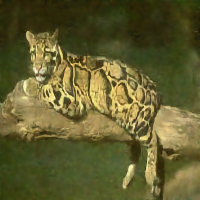

 
 

Image no. : 16077.jpg
Noised Image


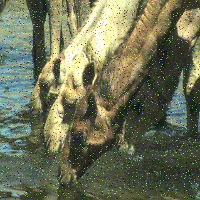

Cleaned Image


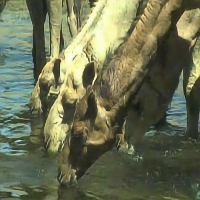

 
 

Image no. : 163085.jpg
Noised Image


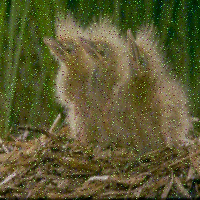

Cleaned Image


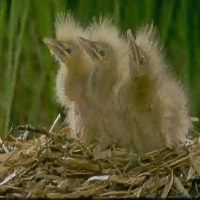

 
 

Image no. : 167062.jpg
Noised Image


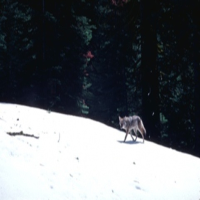

Cleaned Image


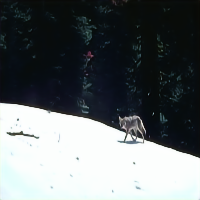

 
 

Image no. : 167083.jpg
Noised Image


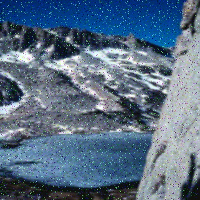

Cleaned Image


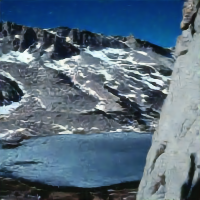

 
 

Image no. : 170057.jpg
Noised Image


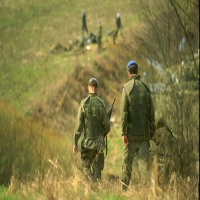

Cleaned Image


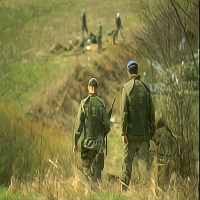

 
 

Image no. : 175032.jpg
Noised Image


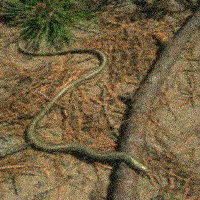

Cleaned Image


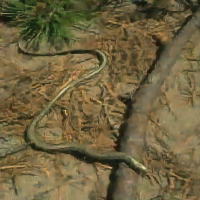

 
 

Image no. : 175043.jpg
Noised Image


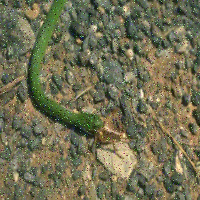

Cleaned Image


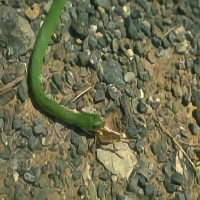

 
 

Image no. : 182053.jpg
Noised Image


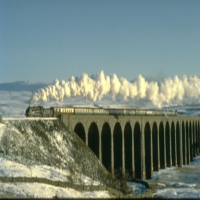

Cleaned Image


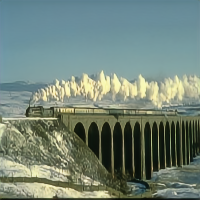

 
 

Image no. : 189080.jpg
Noised Image


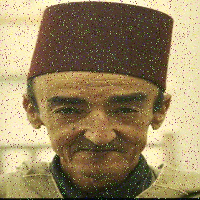

Cleaned Image


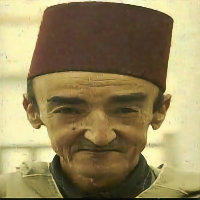

 
 

Image no. : 19021.jpg
Noised Image


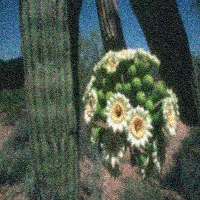

Cleaned Image


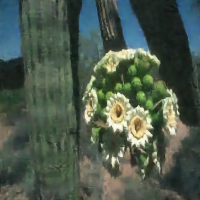

 
 

Image no. : 196073.jpg
Noised Image


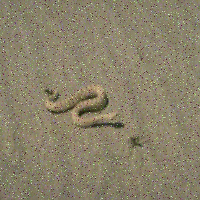

Cleaned Image


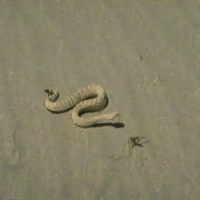

 
 

Image no. : 197017.jpg
Noised Image


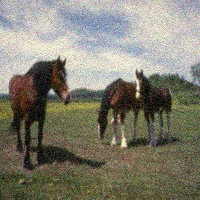

Cleaned Image


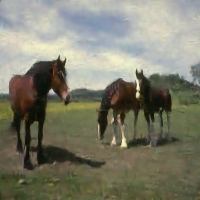

 
 

Image no. : 208001.jpg
Noised Image


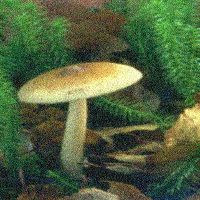

Cleaned Image


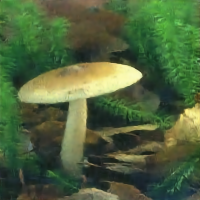

 
 

Image no. : 210088.jpg
Noised Image


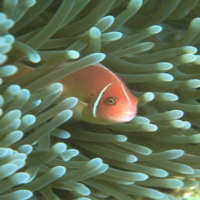

Cleaned Image


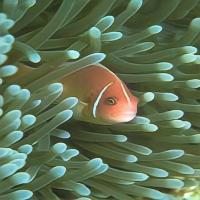

 
 

Image no. : 21077.jpg
Noised Image


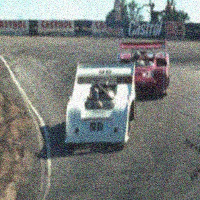

Cleaned Image


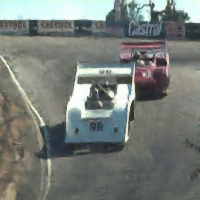

 
 

Image no. : 216081.jpg
Noised Image


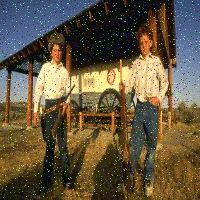

Cleaned Image


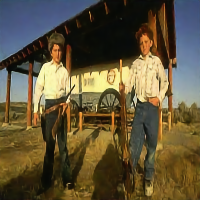

 
 

Image no. : 219090.jpg
Noised Image


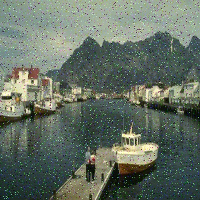

Cleaned Image


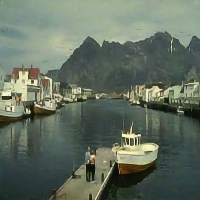

 
 

Image no. : 220075.jpg
Noised Image


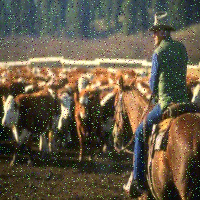

Cleaned Image


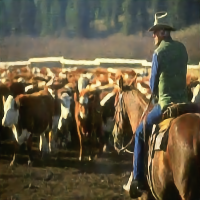

 
 

Image no. : 223061.jpg
Noised Image


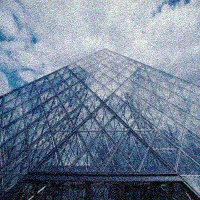

Cleaned Image


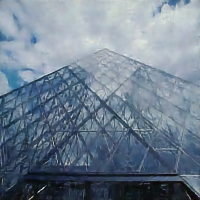

 
 

Image no. : 227092.jpg
Noised Image


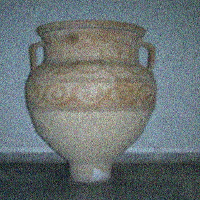

Cleaned Image


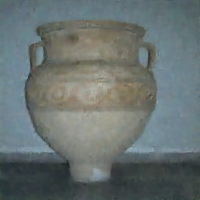

 
 

Image no. : 229036.jpg
Noised Image


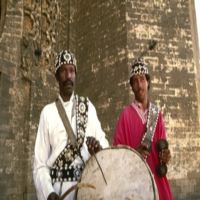

Cleaned Image


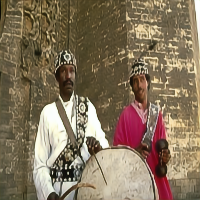

 
 

Image no. : 236037.jpg
Noised Image


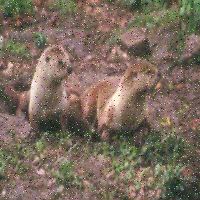

Cleaned Image


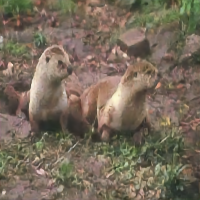

 
 

Image no. : 24077.jpg
Noised Image


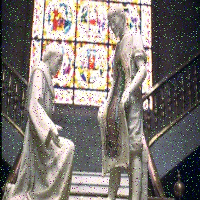

Cleaned Image


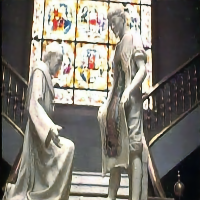

 
 

Image no. : 241004.jpg
Noised Image


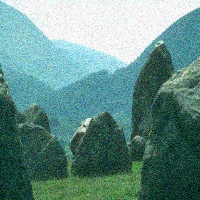

Cleaned Image


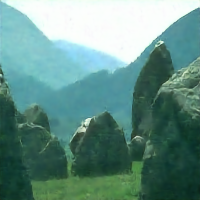

 
 

Image no. : 241048.jpg
Noised Image


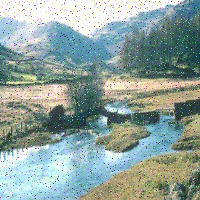

Cleaned Image


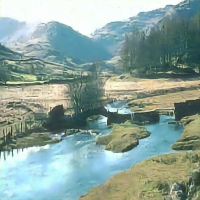

 
 

Image no. : 253027.jpg
Noised Image


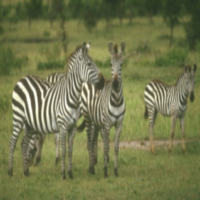

Cleaned Image


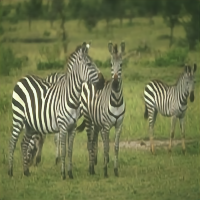

 
 

Image no. : 253055.jpg
Noised Image


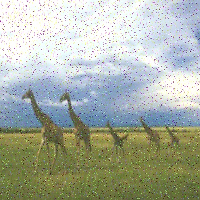

Cleaned Image


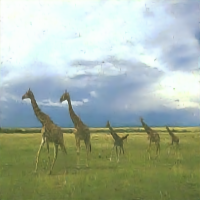

 
 

Image no. : 260058.jpg
Noised Image


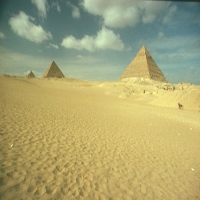

Cleaned Image


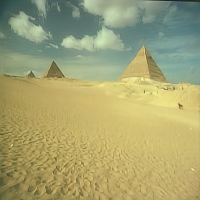

 
 

Image no. : 271035.jpg
Noised Image


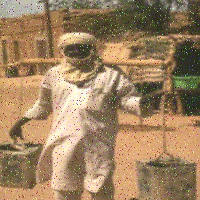

Cleaned Image


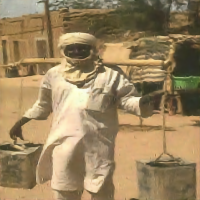

 
 

Image no. : 285079.jpg
Noised Image


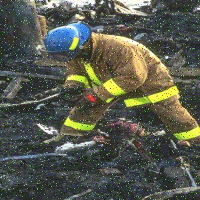

Cleaned Image


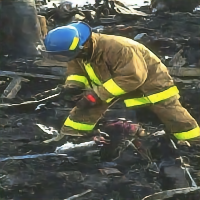

 
 

Image no. : 291000.jpg
Noised Image


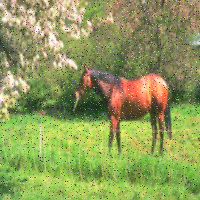

Cleaned Image


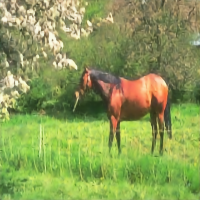

 
 

Image no. : 295087.jpg
Noised Image


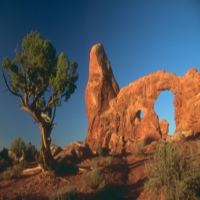

Cleaned Image


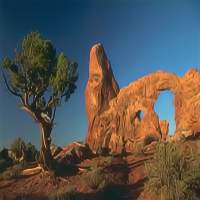

 
 

Image no. : 296007.jpg
Noised Image


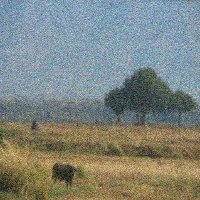

Cleaned Image


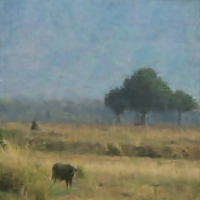

 
 

Image no. : 296059.jpg
Noised Image


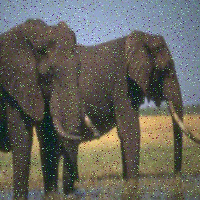

Cleaned Image


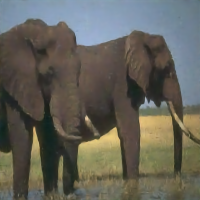

 
 

Image no. : 299086.jpg
Noised Image


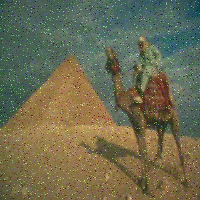

Cleaned Image


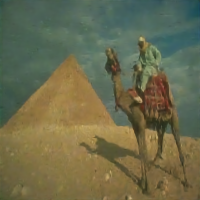

 
 

Image no. : 300091.jpg
Noised Image


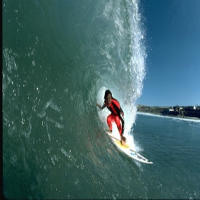

Cleaned Image


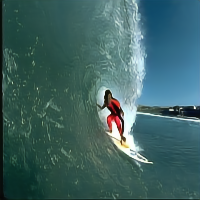

 
 

Image no. : 302008.jpg
Noised Image


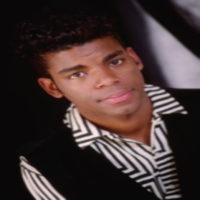

Cleaned Image


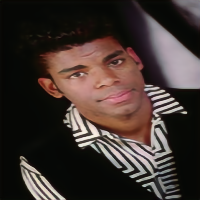

 
 

Image no. : 304034.jpg
Noised Image


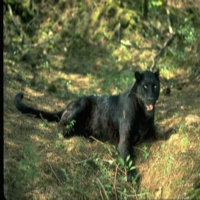

Cleaned Image


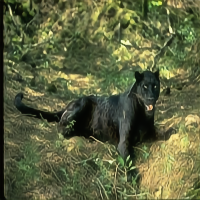

 
 

Image no. : 304074.jpg
Noised Image


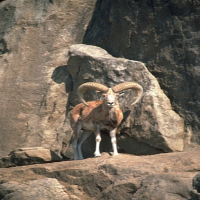

Cleaned Image


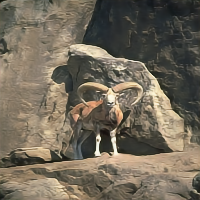

 
 

Image no. : 306005.jpg
Noised Image


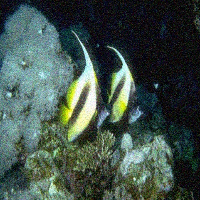

Cleaned Image


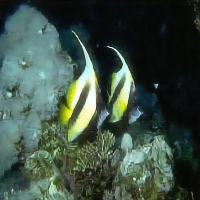

 
 

Image no. : 3096.jpg
Noised Image


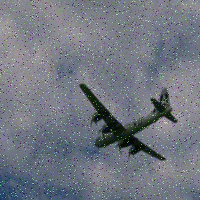

Cleaned Image


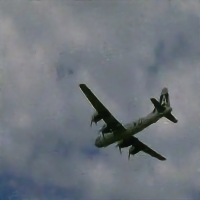

 
 

Image no. : 33039.jpg
Noised Image


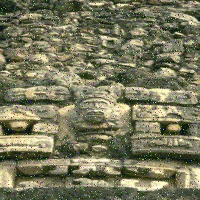

Cleaned Image


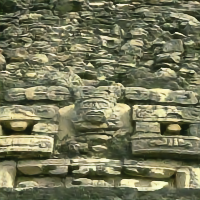

 
 

Image no. : 351093.jpg
Noised Image


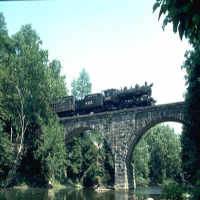

Cleaned Image


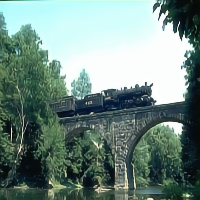

 
 

Image no. : 361010.jpg
Noised Image


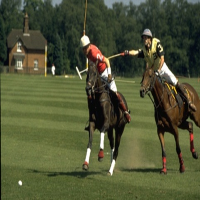

Cleaned Image


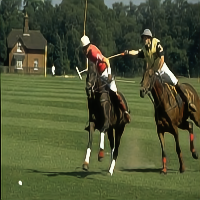

 
 

Image no. : 37073.jpg
Noised Image


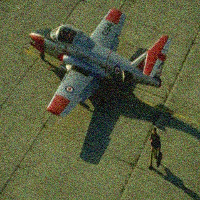

Cleaned Image


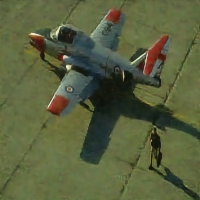

 
 

Image no. : 376043.jpg
Noised Image


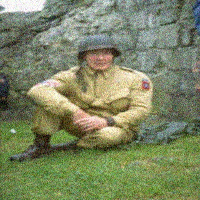

Cleaned Image


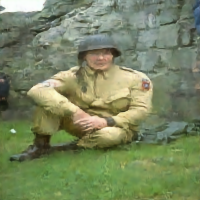

 
 

Image no. : 38082.jpg
Noised Image


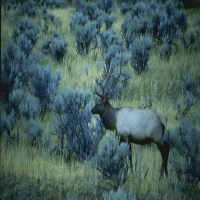

Cleaned Image


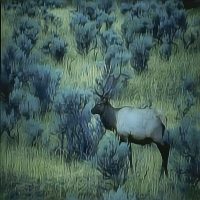

 
 

Image no. : 38092.jpg
Noised Image


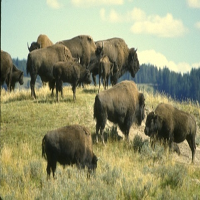

Cleaned Image


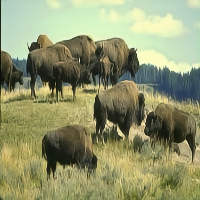

 
 

Image no. : 385039.jpg
Noised Image


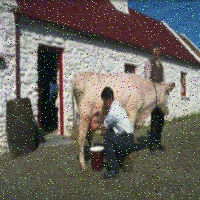

Cleaned Image


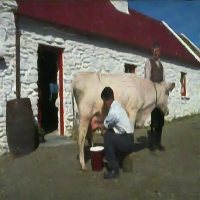

 
 

Image no. : 41033.jpg
Noised Image


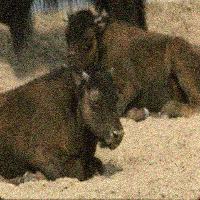

Cleaned Image


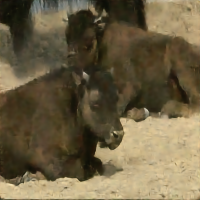

 
 

Image no. : 41069.jpg
Noised Image


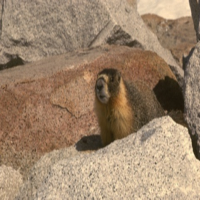

Cleaned Image


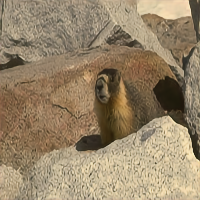

 
 

Image no. : 42012.jpg
Noised Image


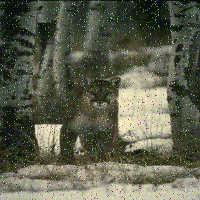

Cleaned Image


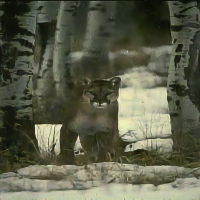

 
 

Image no. : 42049.jpg
Noised Image


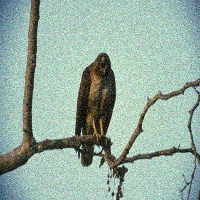

Cleaned Image


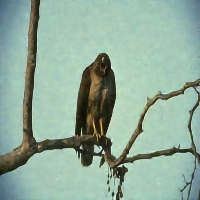

 
 

Image no. : 43074.jpg
Noised Image


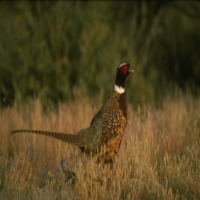

Cleaned Image


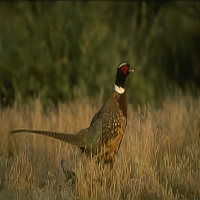

 
 

Image no. : 45096.jpg
Noised Image


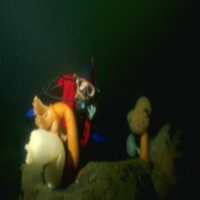

Cleaned Image


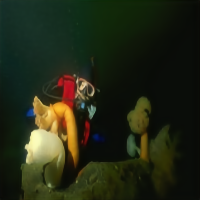

 
 

Image no. : 54082.jpg
Noised Image


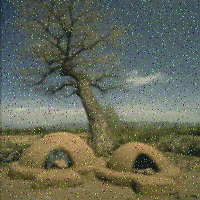

Cleaned Image


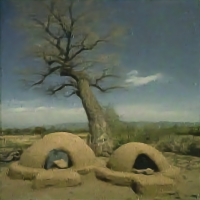

 
 

Image no. : 55073.jpg
Noised Image


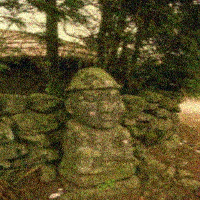

Cleaned Image


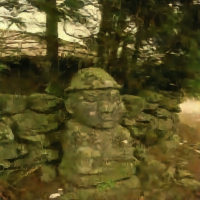

 
 

Image no. : 58060.jpg
Noised Image


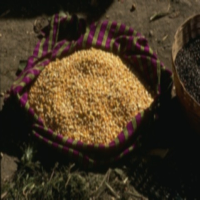

Cleaned Image


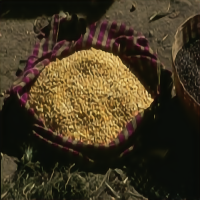

 
 

Image no. : 62096.jpg
Noised Image


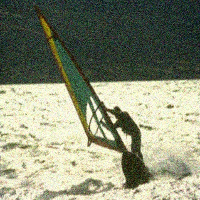

Cleaned Image


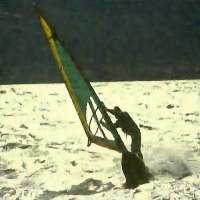

 
 

Image no. : 65033.jpg
Noised Image


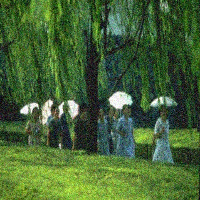

Cleaned Image


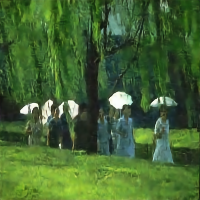

 
 

Image no. : 66053.jpg
Noised Image


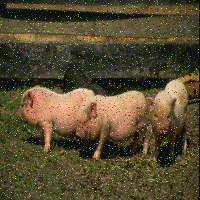

Cleaned Image


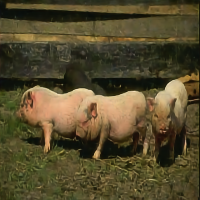

 
 

Image no. : 69015.jpg
Noised Image


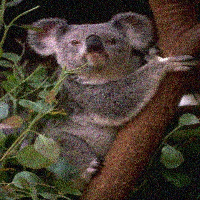

Cleaned Image


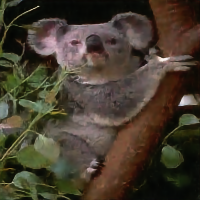

 
 

Image no. : 69020.jpg
Noised Image


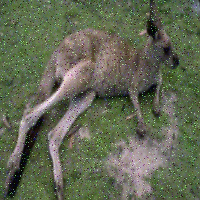

Cleaned Image


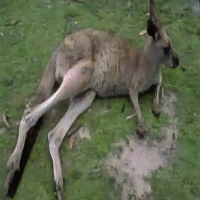

 
 

Image no. : 69040.jpg
Noised Image


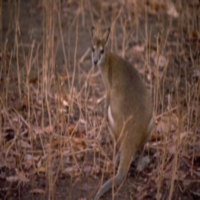

Cleaned Image


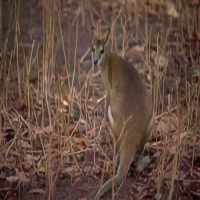

 
 

Image no. : 76053.jpg
Noised Image


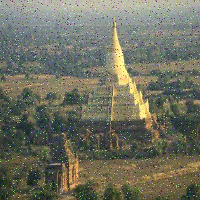

Cleaned Image


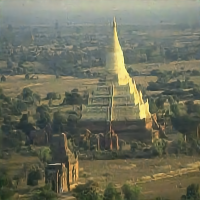

 
 

Image no. : 78004.jpg
Noised Image


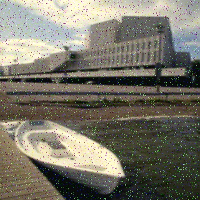

Cleaned Image


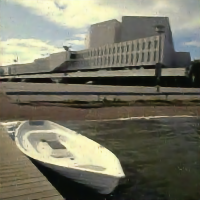

 
 

Image no. : 8023.jpg
Noised Image


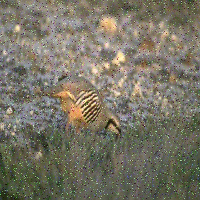

Cleaned Image


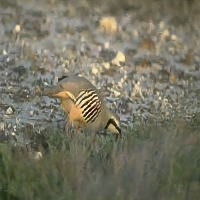

 
 

Image no. : 85048.jpg
Noised Image


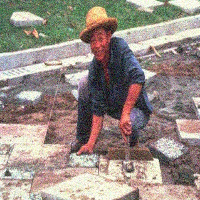

Cleaned Image


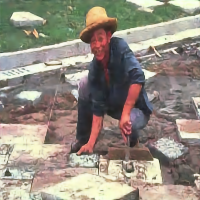

 
 

Image no. : 86000.jpg
Noised Image


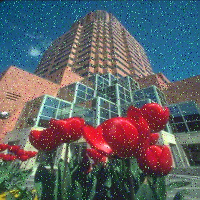

Cleaned Image


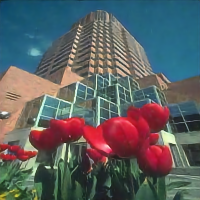

 
 

Image no. : 86016.jpg
Noised Image


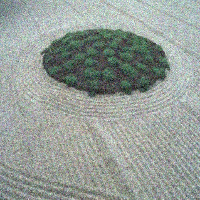

Cleaned Image


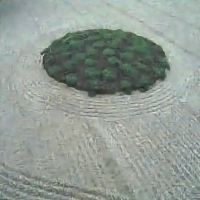

 
 

Image no. : 86068.jpg
Noised Image


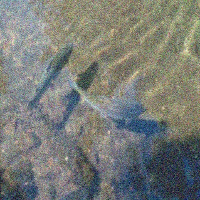

Cleaned Image


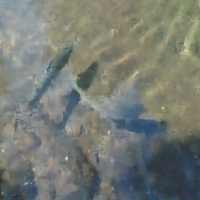

 
 

Image no. : 87046.jpg
Noised Image


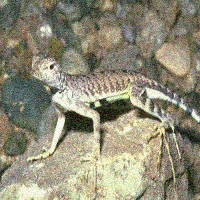

Cleaned Image


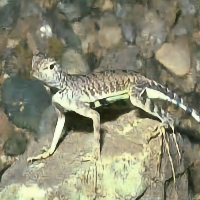

 
 

Image no. : 89072.jpg
Noised Image


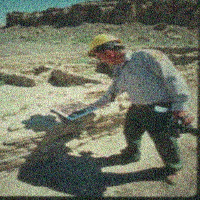

Cleaned Image


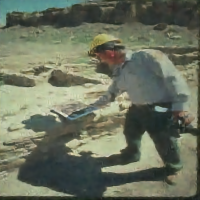

 
 

Image no. : 97033.jpg
Noised Image


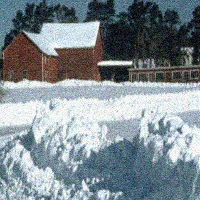

Cleaned Image


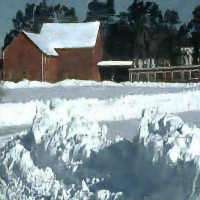

In [ ]:
# model.save('model_3')

# predict/clean test images
Y_test = model.predict(X_test, batch_size=16)
for i in range(0,len(Y_test)):
    print('Image no. :', test_img[i])
    print('Noised Image')
    cv2_imshow(X_test[i]*255.0)
    print('Cleaned Image')
    cv2_imshow(Y_test[i]*255.0)
    print(" ")
    print(" ")
    print()

#Comments/Inferences on predicted deoised images
- The model performes very well on *salt & pepper* and *gaussian* noised images
- Salt & pepper noises are completely removed
- The output image is even sharper than denoised image
- The sharpness in general is however low due to the resizing of training dataset from (381, 421) to (200, 200)
- Sharpened Image can be seen in ``` 253027.jpg, 295087.jpg```
- However some images are still unsharpened like ```296007.jpg, 376043.jpg```

# Extra Comments:
- **Learning rate Scheduling** and **Sanity checking** were the most essential and important steps in the whole model training and which resulted in getting good prediction in testing dataset
- However due to the limited dataset, the model is very much prone to the problem of **Concept drift**
- After testing images outside the BSDS300 dataset, the performs worse than BSDS300 dataset. The blurring effect is suppressed identically but noises are not suppresed like above
- Also the training dataset has mostly nature inspired and bright images. So model performs worse in dark images like ``` 38082.jpg, 41033.jpg, ```

#References
###Dataloading
- https://keras.io/api/preprocessing/image/
- https://keras.io/examples/vision/mirnet/

###LR Scheduling
- https://keras.io/api/callbacks/learning_rate_scheduler/
- https://towardsdatascience.com/learning-rate-schedule-in-practice-an-example-with-keras-and-tensorflow-2-0-2f48b2888a0c#:~:text=The%20constant%20learning%20rate%20is%20the%20default%20schedule,And%20to%20fit%20the%20model%20to%20training%20data%3A

###ML modeling
- https://keras.io/
- https://www.coursera.org/learn/introduction-to-machine-learning-in-production

### Metrics and loss functions
- https://keras.io/api/losses/
- https://keras.io/api/metrics/
- https://stackoverflow.com/questions/55844618/how-to-calculate-psnr-metric-in-keras

